<a href="https://colab.research.google.com/github/RavinduPabasara/drought-prediction-prophet/blob/main/drought_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Full Analysis

In [ ]:
# Read the data
df_1 = pd.read_csv('SriLanka_Weather_Dataset.csv')

print("first five entries")
print(df_1.head(5))

first five entries
         time  weathercode  temperature_2m_max  temperature_2m_min  \
0  2010-01-01            2                30.0                22.7   
1  2010-01-02           51                29.9                23.5   
2  2010-01-03           51                29.5                23.2   
3  2010-01-04            2                28.9                21.9   
4  2010-01-05            1                28.1                21.3   

   temperature_2m_mean  apparent_temperature_max  apparent_temperature_min  \
0                 26.1                      34.4                      25.2   
1                 26.2                      33.8                      26.2   
2                 26.0                      34.3                      26.3   
3                 25.3                      31.6                      23.4   
4                 24.5                      30.1                      23.1   

   apparent_temperature_mean           sunrise            sunset  ...  \
0                 

In [ ]:
print("last five entries")
print(df_1.tail(5))

last five entries
              time  weathercode  temperature_2m_max  temperature_2m_min  \
147475  2023-06-13           63                29.2                24.7   
147476  2023-06-14           61                29.1                25.4   
147477  2023-06-15           51                29.8                25.5   
147478  2023-06-16           53                30.5                25.5   
147479  2023-06-17           51                29.6                25.2   

        temperature_2m_mean  apparent_temperature_max  \
147475                 26.6                      35.4   
147476                 26.9                      34.3   
147477                 27.3                      36.6   
147478                 27.7                      36.2   
147479                 26.9                      35.9   

        apparent_temperature_min  apparent_temperature_mean           sunrise  \
147475                      29.2                       31.6  2023-06-13T00:24   
147476                    

In [ ]:
print(df_1.shape)


(147480, 24)


In [ ]:
print("info")
print(df_1.info)

info
<bound method DataFrame.info of               time  weathercode  temperature_2m_max  temperature_2m_min  \
0       2010-01-01            2                30.0                22.7   
1       2010-01-02           51                29.9                23.5   
2       2010-01-03           51                29.5                23.2   
3       2010-01-04            2                28.9                21.9   
4       2010-01-05            1                28.1                21.3   
...            ...          ...                 ...                 ...   
147475  2023-06-13           63                29.2                24.7   
147476  2023-06-14           61                29.1                25.4   
147477  2023-06-15           51                29.8                25.5   
147478  2023-06-16           53                30.5                25.5   
147479  2023-06-17           51                29.6                25.2   

        temperature_2m_mean  apparent_temperature_max  \
0    

In [ ]:
print(df_1.describe)

<bound method NDFrame.describe of               time  weathercode  temperature_2m_max  temperature_2m_min  \
0       2010-01-01            2                30.0                22.7   
1       2010-01-02           51                29.9                23.5   
2       2010-01-03           51                29.5                23.2   
3       2010-01-04            2                28.9                21.9   
4       2010-01-05            1                28.1                21.3   
...            ...          ...                 ...                 ...   
147475  2023-06-13           63                29.2                24.7   
147476  2023-06-14           61                29.1                25.4   
147477  2023-06-15           51                29.8                25.5   
147478  2023-06-16           53                30.5                25.5   
147479  2023-06-17           51                29.6                25.2   

        temperature_2m_mean  apparent_temperature_max  \
0       

In [ ]:
print(df_1[['et0_fao_evapotranspiration']].describe())

       et0_fao_evapotranspiration
count               147480.000000
mean                     3.896143
std                      1.023126
min                      0.420000
25%                      3.260000
50%                      3.890000
75%                      4.550000
max                      8.140000


In [ ]:
print(df_1[['temperature_2m_max']].describe())

       temperature_2m_max
count       147480.000000
mean            29.242367
std              2.120345
min             17.500000
25%             28.200000
50%             29.200000
75%             30.400000
max             37.500000


In [ ]:
print(df_1[['temperature_2m_min']].describe())

       temperature_2m_min
count       147480.000000
mean            23.899913
std              2.059291
min             12.100000
25%             23.100000
50%             24.300000
75%             25.200000
max             30.000000


In [ ]:
print(df_1[['precipitation_sum']].describe())

       precipitation_sum
count      147480.000000
mean            5.975637
std            10.215294
min             0.000000
25%             0.400000
50%             2.600000
75%             7.500000
max           338.800000


In [ ]:
def visualize_sri_lanka_weather(df):
    """
    Comprehensive visualization function for Sri Lankan weather dataset,
    creating separate plots for each city

    Parameters:
    df (pandas.DataFrame): Complete weather dataset with all cities
    """
    # Ensure datetime
    df['time'] = pd.to_datetime(df['time'])
    df['year'] = df['time'].dt.year
    df['month'] = df['time'].dt.month

    # Get unique cities
    cities = df['city'].unique()

    for city in cities:
        city_data = df[df['city'] == city]

        # Create figure with subplots for each city
        fig = make_subplots(
            rows=4, cols=2,
            subplot_titles=(
                'Temperature Pattern',
                'Monthly Rainfall Distribution',
                'Wind Speed vs Temperature',
                'Evapotranspiration Pattern',
                'Daily Temperature Range',
                'Precipitation Hours Distribution',
                'Wind Direction Distribution',
                'Radiation vs Temperature'
            ),
            vertical_spacing=0.12,
            horizontal_spacing=0.1
        )

        # Temperature Patterns - to show the yearly mean maximum temperature for each city.
        yearly_temp = city_data.groupby(city_data['time'].dt.year)['temperature_2m_max'].mean()
        fig.add_trace(
            go.Scatter(
                x=yearly_temp.index,
                y=yearly_temp.values,
                mode='lines+markers',
                name='Max Temperature'
            ),
            row=1, col=1
        )

        # Monthly Rainfall - the mean monthly rainfall distribution for each city.
        monthly_rain = city_data.groupby('month')['precipitation_sum'].mean()
        fig.add_trace(
            go.Scatter(
                x=monthly_rain.index,
                y=monthly_rain.values,
                mode='lines+markers',
                name='Average Rainfall'
            ),
            row=1, col=2
        )

        # relationship between maximum wind speed and maximum temperature.
        fig.add_trace(
            go.Scatter(
                x=city_data['temperature_2m_max'],
                y=city_data['windspeed_10m_max'],
                mode='markers',
                name='Wind vs Temp',
                marker=dict(
                    size=6,
                    opacity=0.6
                )
            ),
            row=2, col=1
        )

        # mean monthly evapotranspiration
        monthly_evap = city_data.groupby('month')['et0_fao_evapotranspiration'].mean()
        fig.add_trace(
            go.Scatter(
                x=monthly_evap.index,
                y=monthly_evap.values,
                mode='lines+markers',
                name='Evapotranspiration'
            ),
            row=2, col=2
        )

        # how the daily temperature range changes.
        # I calculated as the difference between the maximum and minimum emperatures.
        temp_range = city_data['temperature_2m_max'] - city_data['temperature_2m_min']
        fig.add_trace(
            go.Box(
                y=temp_range,
                name='Temp Range'
            ),
            row=3, col=1
        )

        # Shows the distribution of precipitation hours for each city.
        fig.add_trace(
            go.Histogram(
                x=city_data['precipitation_hours'],
                name='Precip Hours',
                opacity=0.7
            ),
            row=3, col=2
        )

        # distribution of the most dominant wind direction
        fig.add_trace(
            go.Histogram(
                x=city_data['winddirection_10m_dominant'],
                name='Wind Direction',
                opacity=0.7
            ),
            row=4, col=1
        )

        #  shortwave radiation against maximum temperature.
        fig.add_trace(
            go.Scatter(
                x=city_data['shortwave_radiation_sum'],
                y=city_data['temperature_2m_max'],
                mode='markers',
                name='Radiation vs Temp',
                marker=dict(
                    size=6,
                    opacity=0.6
                )
            ),
            row=4, col=2
        )

        # Update layout and axes
        fig.update_layout(
            height=2000,
            width=1200,
            title_text=f"{city} Weather Analysis (2010-2023)",
            showlegend=True,
            template='plotly_white'
        )

        # Update x-axis titles
        fig.update_xaxes(title_text="Year", row=1, col=1)
        fig.update_xaxes(title_text="Month", row=1, col=2)
        fig.update_xaxes(title_text="Temperature (°C)", row=2, col=1)
        fig.update_xaxes(title_text="Month", row=2, col=2)
        fig.update_xaxes(title_text="Temperature Range", row=3, col=1)
        fig.update_xaxes(title_text="Precipitation Hours", row=3, col=2)
        fig.update_xaxes(title_text="Wind Direction (degrees)", row=4, col=1)
        fig.update_xaxes(title_text="Shortwave Radiation Sum", row=4, col=2)

        # Update y-axis titles
        fig.update_yaxes(title_text="Average Max Temperature (°C)", row=1, col=1)
        fig.update_yaxes(title_text="Average Precipitation (mm)", row=1, col=2)
        fig.update_yaxes(title_text="Wind Speed (m/s)", row=2, col=1)
        fig.update_yaxes(title_text="Evapotranspiration (mm)", row=2, col=2)
        fig.update_yaxes(title_text="Temperature Range (°C)", row=3, col=1)
        fig.update_yaxes(title_text="Count", row=3, col=2)
        fig.update_yaxes(title_text="Count", row=4, col=1)
        fig.update_yaxes(title_text="Temperature (°C)", row=4, col=2)

        # Show the figure for this city
        fig.show()

        # Print summary statistics for this city
        print(f"\n{city.upper()} WEATHER SUMMARY STATISTICS (2010-2023)")
        print("=" * 50)
        print(f"Elevation: {city_data['elevation'].iloc[0]}m")
        print(f"Location: {city_data['latitude'].iloc[0]}°N, {city_data['longitude'].iloc[0]}°E")
        print("\nTemperature Statistics:")
        print(f"Average Max: {city_data['temperature_2m_max'].mean():.1f}°C")
        print(f"Average Min: {city_data['temperature_2m_min'].mean():.1f}°C")
        print(f"Highest Recorded: {city_data['temperature_2m_max'].max():.1f}°C")
        print(f"Lowest Recorded: {city_data['temperature_2m_min'].min():.1f}°C")
        print("\nRainfall Statistics:")
        print(f"Average Daily Rainfall: {city_data['precipitation_sum'].mean():.1f}mm")
        print(f"Maximum Daily Rainfall: {city_data['precipitation_sum'].max():.1f}mm")
        print(f"Average Precipitation Hours: {city_data['precipitation_hours'].mean():.1f}h")
        print("\nWind Statistics:")
        print(f"Average Max Wind Speed: {city_data['windspeed_10m_max'].mean():.1f}m/s")
        print(f"Maximum Wind Gust: {city_data['windgusts_10m_max'].max():.1f}m/s")
        print("-" * 50)

In [ ]:
# Read the data
df_1 = pd.read_csv('SriLanka_Weather_Dataset.csv')

# Run the visualization
visualize_sri_lanka_weather(df_1)


COLOMBO WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 16.0m
Location: 7.0°N, 79.899994°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 24.4°C
Highest Recorded: 36.1°C
Lowest Recorded: 18.9°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



MOUNT LAVINIA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 10.0m
Location: 6.9000015°N, 79.899994°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 24.3°C
Highest Recorded: 35.9°C
Lowest Recorded: 18.5°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



KESBEWA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 18.0m
Location: 6.800003°N, 79.899994°E

Temperature Statistics:
Average Max: 29.4°C
Average Min: 24.4°C
Highest Recorded: 34.6°C
Lowest Recorded: 19.2°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



MORATUWA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 9.0m
Location: 6.800003°N, 79.899994°E

Temperature Statistics:
Average Max: 29.4°C
Average Min: 24.5°C
Highest Recorded: 34.7°C
Lowest Recorded: 19.2°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



MAHARAGAMA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 26.0m
Location: 6.800003°N, 79.899994°E

Temperature Statistics:
Average Max: 29.3°C
Average Min: 24.4°C
Highest Recorded: 34.6°C
Lowest Recorded: 19.1°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



RATNAPURA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 27.0m
Location: 6.800003°N, 80.30002°E

Temperature Statistics:
Average Max: 28.7°C
Average Min: 22.4°C
Highest Recorded: 34.2°C
Lowest Recorded: 16.0°C

Rainfall Statistics:
Average Daily Rainfall: 7.8mm
Maximum Daily Rainfall: 168.6mm
Average Precipitation Hours: 10.8h

Wind Statistics:
Average Max Wind Speed: 12.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



KANDY WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 510.0m
Location: 7.300003°N, 80.600006°E

Temperature Statistics:
Average Max: 27.1°C
Average Min: 20.6°C
Highest Recorded: 33.4°C
Lowest Recorded: 14.2°C

Rainfall Statistics:
Average Daily Rainfall: 6.3mm
Maximum Daily Rainfall: 259.5mm
Average Precipitation Hours: 7.4h

Wind Statistics:
Average Max Wind Speed: 11.8m/s
Maximum Wind Gust: 77.8m/s
--------------------------------------------------



NEGOMBO WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 5.0m
Location: 7.0999985°N, 79.899994°E

Temperature Statistics:
Average Max: 29.8°C
Average Min: 24.7°C
Highest Recorded: 36.4°C
Lowest Recorded: 19.4°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



SRI JAYEWARDENEPURA KOTTE WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 7.0m
Location: 6.9000015°N, 79.899994°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 24.3°C
Highest Recorded: 35.9°C
Lowest Recorded: 18.5°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



KALMUNAI WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 8.0m
Location: 7.4000015°N, 81.80002°E

Temperature Statistics:
Average Max: 30.4°C
Average Min: 25.4°C
Highest Recorded: 37.5°C
Lowest Recorded: 19.6°C

Rainfall Statistics:
Average Daily Rainfall: 4.2mm
Maximum Daily Rainfall: 161.3mm
Average Precipitation Hours: 6.0h

Wind Statistics:
Average Max Wind Speed: 15.9m/s
Maximum Wind Gust: 71.6m/s
--------------------------------------------------



TRINCOMALEE WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 7.0m
Location: 8.599998°N, 81.20001°E

Temperature Statistics:
Average Max: 30.8°C
Average Min: 25.5°C
Highest Recorded: 36.6°C
Lowest Recorded: 20.2°C

Rainfall Statistics:
Average Daily Rainfall: 3.8mm
Maximum Daily Rainfall: 198.9mm
Average Precipitation Hours: 5.3h

Wind Statistics:
Average Max Wind Speed: 21.5m/s
Maximum Wind Gust: 72.4m/s
--------------------------------------------------



GALLE WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 15.0m
Location: 6.0999985°N, 80.20001°E

Temperature Statistics:
Average Max: 29.8°C
Average Min: 25.0°C
Highest Recorded: 35.1°C
Lowest Recorded: 20.8°C

Rainfall Statistics:
Average Daily Rainfall: 5.7mm
Maximum Daily Rainfall: 177.6mm
Average Precipitation Hours: 10.3h

Wind Statistics:
Average Max Wind Speed: 17.6m/s
Maximum Wind Gust: 76.7m/s
--------------------------------------------------



JAFFNA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 5.0m
Location: 9.700005°N, 80.0°E

Temperature Statistics:
Average Max: 29.5°C
Average Min: 26.4°C
Highest Recorded: 33.8°C
Lowest Recorded: 21.0°C

Rainfall Statistics:
Average Daily Rainfall: 3.4mm
Maximum Daily Rainfall: 196.7mm
Average Precipitation Hours: 4.9h

Wind Statistics:
Average Max Wind Speed: 26.5m/s
Maximum Wind Gust: 75.2m/s
--------------------------------------------------



ATHURUGIRIYA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 27.0m
Location: 6.9000015°N, 79.899994°E

Temperature Statistics:
Average Max: 29.6°C
Average Min: 24.2°C
Highest Recorded: 35.7°C
Lowest Recorded: 18.3°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



WELIGAMA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 5.0m
Location: 6.0°N, 80.399994°E

Temperature Statistics:
Average Max: 28.9°C
Average Min: 24.7°C
Highest Recorded: 34.1°C
Lowest Recorded: 20.2°C

Rainfall Statistics:
Average Daily Rainfall: 5.7mm
Maximum Daily Rainfall: 177.6mm
Average Precipitation Hours: 10.3h

Wind Statistics:
Average Max Wind Speed: 17.6m/s
Maximum Wind Gust: 76.7m/s
--------------------------------------------------



MATARA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 7.0m
Location: 6.0°N, 80.399994°E

Temperature Statistics:
Average Max: 28.9°C
Average Min: 24.6°C
Highest Recorded: 34.1°C
Lowest Recorded: 20.2°C

Rainfall Statistics:
Average Daily Rainfall: 5.7mm
Maximum Daily Rainfall: 177.6mm
Average Precipitation Hours: 10.3h

Wind Statistics:
Average Max Wind Speed: 17.6m/s
Maximum Wind Gust: 76.7m/s
--------------------------------------------------



KOLONNAWA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 13.0m
Location: 6.9000015°N, 79.899994°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 24.3°C
Highest Recorded: 35.8°C
Lowest Recorded: 18.4°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



GAMPAHA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 15.0m
Location: 7.0999985°N, 80.0°E

Temperature Statistics:
Average Max: 29.9°C
Average Min: 24.1°C
Highest Recorded: 36.9°C
Lowest Recorded: 18.4°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



PUTTALAM WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 0.0m
Location: 8.0°N, 79.80002°E

Temperature Statistics:
Average Max: 29.8°C
Average Min: 25.1°C
Highest Recorded: 35.4°C
Lowest Recorded: 20.4°C

Rainfall Statistics:
Average Daily Rainfall: 4.4mm
Maximum Daily Rainfall: 233.5mm
Average Precipitation Hours: 7.1h

Wind Statistics:
Average Max Wind Speed: 16.9m/s
Maximum Wind Gust: 73.1m/s
--------------------------------------------------



BADULLA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 652.0m
Location: 7.0999985°N, 81.100006°E

Temperature Statistics:
Average Max: 27.8°C
Average Min: 20.2°C
Highest Recorded: 34.5°C
Lowest Recorded: 12.7°C

Rainfall Statistics:
Average Daily Rainfall: 5.1mm
Maximum Daily Rainfall: 154.5mm
Average Precipitation Hours: 5.5h

Wind Statistics:
Average Max Wind Speed: 11.0m/s
Maximum Wind Gust: 74.9m/s
--------------------------------------------------



KALUTARA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 0.0m
Location: 6.5999985°N, 80.0°E

Temperature Statistics:
Average Max: 29.1°C
Average Min: 24.4°C
Highest Recorded: 33.5°C
Lowest Recorded: 20.2°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



BENTOTA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 10.0m
Location: 6.5°N, 80.0°E

Temperature Statistics:
Average Max: 28.9°C
Average Min: 24.5°C
Highest Recorded: 33.3°C
Lowest Recorded: 20.3°C

Rainfall Statistics:
Average Daily Rainfall: 7.2mm
Maximum Daily Rainfall: 198.7mm
Average Precipitation Hours: 10.6h

Wind Statistics:
Average Max Wind Speed: 14.3m/s
Maximum Wind Gust: 75.6m/s
--------------------------------------------------



MATALE WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 376.0m
Location: 7.5999985°N, 80.600006°E

Temperature Statistics:
Average Max: 28.9°C
Average Min: 22.2°C
Highest Recorded: 35.5°C
Lowest Recorded: 15.4°C

Rainfall Statistics:
Average Daily Rainfall: 5.3mm
Maximum Daily Rainfall: 300.4mm
Average Precipitation Hours: 6.5h

Wind Statistics:
Average Max Wind Speed: 14.7m/s
Maximum Wind Gust: 77.8m/s
--------------------------------------------------



MANNAR WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 6.0m
Location: 8.900002°N, 80.0°E

Temperature Statistics:
Average Max: 29.8°C
Average Min: 25.7°C
Highest Recorded: 34.6°C
Lowest Recorded: 20.1°C

Rainfall Statistics:
Average Daily Rainfall: 3.1mm
Maximum Daily Rainfall: 112.1mm
Average Precipitation Hours: 4.7h

Wind Statistics:
Average Max Wind Speed: 24.3m/s
Maximum Wind Gust: 78.1m/s
--------------------------------------------------



POTHUHERA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 125.0m
Location: 7.4000015°N, 80.30002°E

Temperature Statistics:
Average Max: 29.4°C
Average Min: 22.7°C
Highest Recorded: 37.1°C
Lowest Recorded: 16.7°C

Rainfall Statistics:
Average Daily Rainfall: 5.4mm
Maximum Daily Rainfall: 338.8mm
Average Precipitation Hours: 7.5h

Wind Statistics:
Average Max Wind Speed: 14.8m/s
Maximum Wind Gust: 75.2m/s
--------------------------------------------------



KURUNEGALA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 124.0m
Location: 7.5°N, 80.399994°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 22.9°C
Highest Recorded: 37.3°C
Lowest Recorded: 17.3°C

Rainfall Statistics:
Average Daily Rainfall: 5.4mm
Maximum Daily Rainfall: 338.8mm
Average Precipitation Hours: 7.5h

Wind Statistics:
Average Max Wind Speed: 14.8m/s
Maximum Wind Gust: 75.2m/s
--------------------------------------------------



MABOLE WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 16.0m
Location: 7.0°N, 79.899994°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 24.4°C
Highest Recorded: 36.1°C
Lowest Recorded: 18.9°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------



HATTON WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 1281.0m
Location: 6.9000015°N, 80.600006°E

Temperature Statistics:
Average Max: 23.7°C
Average Min: 18.0°C
Highest Recorded: 28.3°C
Lowest Recorded: 12.1°C

Rainfall Statistics:
Average Daily Rainfall: 7.1mm
Maximum Daily Rainfall: 149.3mm
Average Precipitation Hours: 8.8h

Wind Statistics:
Average Max Wind Speed: 10.1m/s
Maximum Wind Gust: 91.8m/s
--------------------------------------------------



HAMBANTOTA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 12.0m
Location: 6.2000046°N, 81.20001°E

Temperature Statistics:
Average Max: 30.5°C
Average Min: 24.9°C
Highest Recorded: 34.8°C
Lowest Recorded: 19.0°C

Rainfall Statistics:
Average Daily Rainfall: 2.9mm
Maximum Daily Rainfall: 122.2mm
Average Precipitation Hours: 4.4h

Wind Statistics:
Average Max Wind Speed: 19.8m/s
Maximum Wind Gust: 75.2m/s
--------------------------------------------------



ORUWALA WEATHER SUMMARY STATISTICS (2010-2023)
Elevation: 20.0m
Location: 6.9000015°N, 80.0°E

Temperature Statistics:
Average Max: 29.7°C
Average Min: 23.8°C
Highest Recorded: 35.8°C
Lowest Recorded: 18.4°C

Rainfall Statistics:
Average Daily Rainfall: 6.8mm
Maximum Daily Rainfall: 261.8mm
Average Precipitation Hours: 10.2h

Wind Statistics:
Average Max Wind Speed: 14.2m/s
Maximum Wind Gust: 70.9m/s
--------------------------------------------------


In [ ]:
df_1.drop(columns=['country'], inplace=True)

Dropped the country as it stays same throughout the dataset

In [ ]:
# Get list of unique cities
cities = df_1['city'].unique()
print("Cities in the dataset:")
for city in cities:
    print(f"- {city}")

Cities in the dataset:
- Colombo
- Mount Lavinia
- Kesbewa
- Moratuwa
- Maharagama
- Ratnapura
- Kandy
- Negombo
- Sri Jayewardenepura Kotte
- Kalmunai
- Trincomalee
- Galle
- Jaffna
- Athurugiriya
- Weligama
- Matara
- Kolonnawa
- Gampaha
- Puttalam
- Badulla
- Kalutara
- Bentota
- Matale
- Mannar
- Pothuhera
- Kurunegala
- Mabole
- Hatton
- Hambantota
- Oruwala


when we consider these city list As I am planning to predict droughts, Considering urban areas are not necessary. So I am ordering them to most agricultural to least agricultural.

In order:

Ratnapura, Hambantota, Mannar, Puttalam, Matale, Badulla, Kandy, Kurunegala, Gampaha, Kalutara, Matara, Weligama, Trincomalee, Jaffna, Kalmunai, Galle, Kesbewa, Maharagama, Colombo, Mount Lavinia, Sri Jayewardenepura Kotte, Kolonnawa, Negombo, Bentota, Athurugiriya, Hatton, Pothuhera, Mabole, Moratuwa, Oruwala

with urbanization, cities like Colombo, Mount Lavinia, and Moratuwa are more focused on industrial, residential, and commercial side than agricultural significance. Tourist destinations like Bentota and Galle, while having some agricultural activities, lean more toward tourism.

Cities like Ratnapura and Hambantota are highly agricultural due to their dependence on gem mining, paddy, and livestock, as well as extensive arable land. Mannar, Puttalam, and Matale are also key agricultural hubs for crops like onions, chillies, and coconut. Hill country regions like Badulla and Kandy thrive on tea, spices, and paddy farming.

In [ ]:
null_counts = df_1.isnull().sum()
print(null_counts)

time                          0
weathercode                   0
temperature_2m_max            0
temperature_2m_min            0
temperature_2m_mean           0
apparent_temperature_max      0
apparent_temperature_min      0
apparent_temperature_mean     0
sunrise                       0
sunset                        0
shortwave_radiation_sum       0
precipitation_sum             0
rain_sum                      0
snowfall_sum                  0
precipitation_hours           0
windspeed_10m_max             0
windgusts_10m_max             0
winddirection_10m_dominant    0
et0_fao_evapotranspiration    0
latitude                      0
longitude                     0
elevation                     0
city                          0
year                          0
month                         0
dtype: int64


Also the weather dataset is quite consistant with no null values.

In [ ]:
print(df_1['weathercode'].value_counts())

weathercode
51    37559
63    27477
61    22690
53    22308
2     10388
1      9438
55     7794
3      5877
65     2925
0      1024
Name: count, dtype: int64


#Test01

The Prophet model was chosen for this task. It is specifically designed for time series forecasting with strong seasonality and trend components. That makes it ideal for predicting drought-related variables such as temperature, precipitation, and evapotranspiration.

Prophet can handle missing data and outliers efficiently. also it handles  irregular time intervals . those features work well with climate data.

Prophet has built-in functionalities for additive and multiplicative seasonality. enables the accurate modeling of weather patterns

The model is very flexibile and easy to implement. That allows for efficient scaling across multiple features and cities. Also it has a uncertainty intervals. So it is also important as dealing with weather-like datasets

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from prophet import Prophet
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots



I chose two cities for the testing and demonstration purposes as training many models for each city is computaionally expensive and time consuming. Chose Rathnapura as a prominant agricultaral area and chose Matara because it is my home city.

In [ ]:
# Read and preprocess the data
def load_and_preprocess_data(file_path):
    """
    Load and preprocess the weather data for drought prediction
    """
    df = pd.read_csv(file_path)

    # Convert time to datetime
    df['time'] = pd.to_datetime(df['time'])

    # Filter for Ratnapura and Matara
    df = df[df['city'].isin(['Ratnapura', 'Matara'])]

    # Select relevant features for drought prediction
    drought_features = [
        'time', 'city', 'temperature_2m_max', 'precipitation_sum',
        'et0_fao_evapotranspiration'
    ]

    df = df[drought_features]

    return df



In [ ]:
def create_prophet_data(df, city_name, feature):
    """
    Prepare data for Prophet model
    """
    city_data = df[df['city'] == city_name].copy()
    prophet_df = pd.DataFrame({
        'ds': city_data['time'],
        'y': city_data[feature]
    })
    return prophet_df



In [ ]:
def train_and_forecast(df, periods=30):
    """
    Train Prophet model and make forecasts
    """
    model = Prophet(
        yearly_seasonality=True,
        weekly_seasonality=True,
        daily_seasonality=False,
        seasonality_mode='multiplicative'
    )

    model.fit(df)

    # Create future dates dataframe
    future = model.make_future_dataframe(periods=periods)

    # Make predictions
    forecast = model.predict(future)

    return model, forecast



In [ ]:
def plot_forecast_components(model, forecast, feature_name, city):
    """
    Create interactive plots for forecast components
    """
    # Create subplots
    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=(
            f'{feature_name} Forecast for {city}',
            'Yearly Seasonality',
            'Weekly Seasonality',
            'Trend'
        )
    )

    # Add forecast plot
    fig.add_trace(
        go.Scatter(x=forecast['ds'], y=forecast['yhat'], name='Forecast'),
        row=1, col=1
    )
    fig.add_trace(
        go.Scatter(x=forecast['ds'], y=forecast['yhat_upper'],
                  name='Upper Bound', line=dict(dash='dash')),
        row=1, col=1
    )
    fig.add_trace(
        go.Scatter(x=forecast['ds'], y=forecast['yhat_lower'],
                  name='Lower Bound', line=dict(dash='dash')),
        row=1, col=1
    )

    # Add components
    fig.add_trace(
        go.Scatter(x=forecast['ds'], y=forecast['yearly'],
                  name='Yearly Seasonality'),
        row=1, col=2
    )
    fig.add_trace(
        go.Scatter(x=forecast['ds'], y=forecast['weekly'],
                  name='Weekly Seasonality'),
        row=2, col=1
    )
    fig.add_trace(
        go.Scatter(x=forecast['ds'], y=forecast['trend'],
                  name='Trend'),
        row=2, col=2
    )

    fig.update_layout(height=800, title_text=f"Forecast Components for {feature_name} - {city}")
    return fig



In [ ]:
# Main execution
def main(file_path):
    # Load and preprocess data
    df = load_and_preprocess_data(file_path)

    # Features to predict
    features = ['temperature_2m_max', 'precipitation_sum', 'et0_fao_evapotranspiration']
    cities = ['Ratnapura', 'Matara']

    # Store forecasts
    all_forecasts = {}

    for city in cities:
        city_forecasts = {}
        for feature in features:
            # Prepare data for Prophet
            prophet_df = create_prophet_data(df, city, feature)

            # Train model and get forecast
            model, forecast = train_and_forecast(prophet_df)

            # Create visualization
            fig = plot_forecast_components(model, forecast, feature, city)
            fig.show()

            # Store forecasts
            city_forecasts[feature] = forecast

        all_forecasts[city] = city_forecasts

    return all_forecasts


In [ ]:
#  run the main function
all_forecasts = main('SriLanka_Weather_Dataset.csv')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/1u7bmtjo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/2l9b4rab.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57588', 'data', 'file=/tmp/tmpeditps43/1u7bmtjo.json', 'init=/tmp/tmpeditps43/2l9b4rab.json', 'output', 'file=/tmp/tmpeditps43/prophet_modelpm_68j_p/prophet_model-20241219163604.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:36:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:36:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/8c95ljsx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/rdr_520y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45812', 'data', 'file=/tmp/tmpeditps43/8c95ljsx.json', 'init=/tmp/tmpeditps43/rdr_520y.json', 'output', 'file=/tmp/tmpeditps43/prophet_modelyhp4fkea/prophet_model-20241219163607.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:36:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:36:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/xwk2otoy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/n1i7wk68.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22984', 'data', 'file=/tmp/tmpeditps43/xwk2otoy.json', 'init=/tmp/tmpeditps43/n1i7wk68.json', 'output', 'file=/tmp/tmpeditps43/prophet_modelqgrfu3j1/prophet_model-20241219163609.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:36:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:36:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/495jo7zq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/v8ib694v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34075', 'data', 'file=/tmp/tmpeditps43/495jo7zq.json', 'init=/tmp/tmpeditps43/v8ib694v.json', 'output', 'file=/tmp/tmpeditps43/prophet_modeljspr8rhx/prophet_model-20241219163612.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:36:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:36:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/qnic7pop.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/i1ay_zs0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71081', 'data', 'file=/tmp/tmpeditps43/qnic7pop.json', 'init=/tmp/tmpeditps43/i1ay_zs0.json', 'output', 'file=/tmp/tmpeditps43/prophet_modelgfswnpph/prophet_model-20241219163615.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:36:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:36:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/6rku2w3_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/c3vv25sp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98704', 'data', 'file=/tmp/tmpeditps43/6rku2w3_.json', 'init=/tmp/tmpeditps43/c3vv25sp.json', 'output', 'file=/tmp/tmpeditps43/prophet_modellkk5lq1r/prophet_model-20241219163617.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:36:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:36:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


#Test 02

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from prophet import Prophet
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Previous functions remain the same
def load_and_preprocess_data(file_path):
    df = pd.read_csv(file_path)
    df['time'] = pd.to_datetime(df['time'])
    df = df[df['city'].isin(['Ratnapura', 'Matara'])]
    drought_features = [
        'time', 'city', 'temperature_2m_max', 'precipitation_sum',
        'et0_fao_evapotranspiration'
    ]
    df = df[drought_features]
    return df

def create_prophet_data(df, city_name, feature):
    city_data = df[df['city'] == city_name].copy()
    prophet_df = pd.DataFrame({
        'ds': city_data['time'],
        'y': city_data[feature]
    })
    return prophet_df

def train_and_forecast(df, periods=30):
    model = Prophet(
        yearly_seasonality=True,
        weekly_seasonality=True,
        daily_seasonality=False,
        seasonality_mode='multiplicative'
    )

    model.fit(df)
    future = model.make_future_dataframe(periods=periods)
    forecast = model.predict(future)
    return model, forecast

# New function to display forecasts
def display_forecasts(all_forecasts, feature_names):
    """
    Display the next 30 days of forecasts for each city and feature

    Parameters:
    all_forecasts (dict): Dictionary containing forecasts for each city and feature
    feature_names (dict): Dictionary mapping feature names to display names
    """
    for city, forecasts in all_forecasts.items():
        print(f"\n{'='*80}")
        print(f"Forecasts for {city}")
        print(f"{'='*80}")

        # Get the last 30 days of forecasts for each feature
        feature_dfs = {}
        for feature, forecast in forecasts.items():
            # Select only future dates (last 30 rows)
            future_forecast = forecast.tail(30)[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
            feature_dfs[feature] = future_forecast

        # Combine all features into one DataFrame
        combined_df = feature_dfs[list(feature_dfs.keys())[0]][['ds']].copy()
        for feature, df in feature_dfs.items():
            display_name = feature_names[feature]
            combined_df[f"{display_name} (Forecast)"] = df['yhat'].round(2)
            combined_df[f"{display_name} (Lower)"] = df['yhat_lower'].round(2)
            combined_df[f"{display_name} (Upper)"] = df['yhat_upper'].round(2)

        # Format the date column
        combined_df['ds'] = combined_df['ds'].dt.strftime('%Y-%m-%d')
        combined_df = combined_df.rename(columns={'ds': 'Date'})

        # Display the forecasts
        pd.set_option('display.max_columns', None)
        pd.set_option('display.width', None)
        print("\nDaily forecasts with 95% confidence intervals:")
        print(combined_df.to_string(index=False))

        # Calculate and display summary statistics
        print(f"\nSummary Statistics for {city}:")
        print("-" * 40)
        for feature in feature_dfs.keys():
            display_name = feature_names[feature]
            mean_forecast = feature_dfs[feature]['yhat'].mean()
            max_forecast = feature_dfs[feature]['yhat'].max()
            min_forecast = feature_dfs[feature]['yhat'].min()
            print(f"\n{display_name}:")
            print(f"Average: {mean_forecast:.2f}")
            print(f"Maximum: {max_forecast:.2f}")
            print(f"Minimum: {min_forecast:.2f}")

def main(file_path):
    # Load and preprocess data
    df = load_and_preprocess_data(file_path)

    # Features to predict with their display names
    feature_names = {
        'temperature_2m_max': 'Maximum Temperature (°C)',
        'precipitation_sum': 'Precipitation (mm)',
        'et0_fao_evapotranspiration': 'Evapotranspiration (mm)'
    }

    features = list(feature_names.keys())
    cities = ['Ratnapura', 'Matara']

    # Store forecasts
    all_forecasts = {}

    for city in cities:
        city_forecasts = {}
        for feature in features:
            # Prepare data for Prophet
            prophet_df = create_prophet_data(df, city, feature)

            # Train model and get forecast
            model, forecast = train_and_forecast(prophet_df)

            # Store forecasts
            city_forecasts[feature] = forecast

        all_forecasts[city] = city_forecasts

    # Display numerical forecasts
    display_forecasts(all_forecasts, feature_names)

    return all_forecasts

# Run the analysis with:
# all_forecasts = main('SriLanka_Weather_Dataset.csv')

In [ ]:
all_forecasts = main('SriLanka_Weather_Dataset.csv')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/74_r3idk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/4xmy2k84.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34426', 'data', 'file=/tmp/tmpeditps43/74_r3idk.json', 'init=/tmp/tmpeditps43/4xmy2k84.json', 'output', 'file=/tmp/tmpeditps43/prophet_modelbkwhkxal/prophet_model-20241219141242.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
14:12:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
14:12:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/je58olka.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpeditps43/7hztvkjk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/


Forecasts for Ratnapura

Daily forecasts with 95% confidence intervals:
      Date  Maximum Temperature (°C) (Forecast)  Maximum Temperature (°C) (Lower)  Maximum Temperature (°C) (Upper)  Precipitation (mm) (Forecast)  Precipitation (mm) (Lower)  Precipitation (mm) (Upper)  Evapotranspiration (mm) (Forecast)  Evapotranspiration (mm) (Lower)  Evapotranspiration (mm) (Upper)
2023-06-18                                27.57                             26.42                             28.84                           6.57                       -6.79                       20.09                                3.13                             2.23                             3.97
2023-06-19                                27.54                             26.32                             28.80                           7.06                       -4.73                       20.08                                3.12                             2.26                             3.99
2023-06-20  

In [ ]:
# def create_prophet_data(df, city, feature):
#     """
#     Prepares data for Prophet model including additional regressors
#     """
#     city_data = df[df['city'] == city].copy()

#     # Base Prophet dataframe
#     prophet_df = pd.DataFrame({
#         'ds': city_data['time'],
#         'y': city_data[feature]
#     })

#     # Add important derived features as regressors
#     regressor_columns = [
#         'temp_range',
#         'relative_humidity',
#         'day_length',
#         f'{feature}_rolling_mean_7d',
#         f'{feature}_rolling_mean_30d',
#         f'{feature}_rolling_std_30d'
#     ]

#     # Add only existing columns
#     for col in regressor_columns:
#         if col in city_data.columns:
#             prophet_df[col] = city_data[col]

#     # One-hot encode season
#     season_dummies = pd.get_dummies(city_data['season'], prefix='season')
#     prophet_df = pd.concat([prophet_df, season_dummies], axis=1)

#     return prophet_df

# Final

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, RobustScaler
from datetime import datetime

def load_and_preprocess_data(file_path):
    """
    data loading and preprocessing
    """
    # Load the dataset. This dataset was downloaded from kaggle. its a robust dataset which has 24 features.
    # those features are time, weathercode, temperature_2m_max, temperature_2m_min, temperature_2m_mean, apparent_temperature_max,
    # apparent_temperature_min, apparent_temperature_mean, sunrise, sunset, shortwave_radiation_sum, precipitation_sum, rain_sum, snowfall_sum,
    # precipitation_hours, windspeed_10m_max, windgusts_10m_max, winddirection_10m_dominant, et0_fao_evapotranspiration, latitude, longitude, elevation, city, year, month

    df = pd.read_csv(file_path)

    # Convert time columns to datetime. This is essential as prophet deals with date time type.
    datetime_columns = ['time', 'sunrise', 'sunset']
    for col in datetime_columns:
        df[col] = pd.to_datetime(df[col])

    # Extract temporal features(data that are derived from time-related information like year, month,day of the week.. etc. we use datetime here)
    df['year'] = df['time'].dt.year
    df['month'] = df['time'].dt.month
    df['day_of_week'] = df['time'].dt.dayofweek
    df['day_of_year'] = df['time'].dt.dayofyear

    # Create seasonal features. Even though Sri Lanka does not have prominant four seasons there are some distinction between every three months. so I added those here.
    df['season'] = pd.cut(df['month'],
                         bins=[0, 3, 6, 9, 12],
                         labels=['Winter', 'Spring', 'Summer', 'Fall'])

    # Calculate day length in hours
    df['day_length'] = (pd.to_datetime(df['sunset']) -
                       pd.to_datetime(df['sunrise'])).dt.total_seconds() / 3600

    # Handle missing values. There are no missing values apparent in the dataset. but to stay on the safe side and also as good practice, I applied that.
    #nUsed fillna() method and filled the missing values with the median of the column
    numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
    df[numeric_columns] = df[numeric_columns].fillna(df[numeric_columns].median())

    # Add derived weather features.
    # These features were derived out of the existing features
    # temp range was derived by subtracting the min temperature from the max temperature.
    # is rainy is a binary indicator. It is True if there was any precipitation
    # Calculating relative humidity is explained below.

    df['temp_range'] = df['temperature_2m_max'] - df['temperature_2m_min']
    df['is_rainy'] = df['precipitation_sum'] > 0
    df['relative_humidity'] = calculate_relative_humidity(df)

    # Filter cities.  chose two cities for the testing and demonstration purposes as training many models for each city is computaionally expensive and time consuming.
    # Chose Rathnapura as a prominant agricultaral area and chose Matara because it is my home city.
    df = df[df['city'].isin(['Ratnapura', 'Matara'])]

    return df

def calculate_relative_humidity(df):
    """
    Estimate relative humidity using temperature and dew point. this is called magnus formula. it involves temperature and dew point. it serves as a easier predictor
    """
    # Using Magnus formula
    alpha = 17.27
    beta = 237.7

    temp_mean = df['temperature_2m_mean']
    temp_min = df['temperature_2m_min']  # Using min temp as proxy for dew point

    # Calculate actual vapor pressure
    ed = 6.112 * np.exp((alpha * temp_min) / (beta + temp_min))

    # Calculate saturated vapor pressure
    es = 6.112 * np.exp((alpha * temp_mean) / (beta + temp_mean))

    # Calculate relative humidity
    rh = (ed / es) * 100

    return rh.clip(0, 100)  # Ensure values are between 0-100%

def scale_features(df, features_to_scale):

    # Scale numerical features using RobustScaler. I chose it because it is less sensitive to outliers than standard scaling methods.
    # Instead of using the mean and standard deviation like in StandardScaler, the RobustScaler uses the median and the IQR.
    # X scaled = (X−median)/IQR is the formula

    scaler = RobustScaler()
    df_scaled = df.copy()
    df_scaled[features_to_scale] = scaler.fit_transform(df[features_to_scale])
    return df_scaled, scaler

def create_time_windows(df, target_col, window_sizes=[7, 14, 30]):

    # Create rolling statistics for time series features. the window sizes are weekly, biweekily and monthly. 7,14,30
    # It calculates the rolling mean over the given window for the target column, and then It calculates the rolling standard deviation over the same window for the target column.
    # Then they are grouped by city name.

    df_windows = df.copy()

    for window in window_sizes:
        # Rolling mean
        df_windows[f'{target_col}_rolling_mean_{window}d'] = (
            df_windows.groupby('city')[target_col]
            .rolling(window=window, center=False)
            .mean()
            .reset_index(0, drop=True)
        )

        # Rolling std
        df_windows[f'{target_col}_rolling_std_{window}d'] = (
            df_windows.groupby('city')[target_col]
            .rolling(window=window, center=False)
            .std()
            .reset_index(0, drop=True)
        )

    return df_windows

In [ ]:
#functions for vizualizza

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
import matplotlib.pyplot as plt

def create_temporal_analysis(df):

    # Creates a set of plots to analyze weather data trends and distributions over time.
    # It includes temperature, precipitation, evapotranspiration, and wind speed trends.

    fig = make_subplots(
        rows=3, cols=2,
        subplot_titles=(
            'Temperature Trends', 'Temperature Distribution',
            'Precipitation Patterns', 'Precipitation Distribution',
            'Evapotranspiration Trends', 'Wind Speed Distribution'
        )
    )

    # Now this Loop over each city to plot weather data for each city seperately
    for city in df['city'].unique():
        city_data = df[df['city'] == city]

        # Plot temperature trends and distribution (line plot and box plot)
        fig.add_trace(
            go.Scatter(
                x=city_data['time'],
                y=city_data['temperature_2m_max'],
                name=f'{city} Max Temp',
                mode='lines'
            ),
            row=1, col=1
        )

        fig.add_trace(
            go.Box(
                y=city_data['temperature_2m_max'],
                x=city_data['month'],
                name=f'{city} Temp',
                showlegend=False
            ),
            row=1, col=2
        )

        # # Plot precipitation trends and distribution (line plot and box plot)
        fig.add_trace(
            go.Scatter(
                x=city_data['time'],
                y=city_data['precipitation_sum'],
                name=f'{city} Precip',
                mode='lines'
            ),
            row=2, col=1
        )

        fig.add_trace(
            go.Box(
                y=city_data['precipitation_sum'],
                x=city_data['month'],
                name=f'{city} Precip',
                showlegend=False
            ),
            row=2, col=2
        )

        # Plot evapotranspiration and wind speed (line plot and box plot)
        fig.add_trace(
            go.Scatter(
                x=city_data['time'],
                y=city_data['et0_fao_evapotranspiration'],
                name=f'{city} Evap',
                mode='lines'
            ),
            row=3, col=1
        )

        fig.add_trace(
            go.Box(
                y=city_data['windspeed_10m_max'],
                x=city_data['month'],
                name=f'{city} Wind',
                showlegend=False
            ),
            row=3, col=2
        )

    fig.update_layout(height=1200, width=1200, title_text="Weather Patterns Analysis")
    return fig

def create_correlation_heatmap(df):

    # This generates a heatmap visualizing the correlation between weather variables.
    # it helps identify relationships between different weather features.

    # Select numerical columns for correlation
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
    correlation_matrix = df[numeric_cols].corr()

    fig = go.Figure(data=go.Heatmap(
        z=correlation_matrix,
        x=correlation_matrix.columns,
        y=correlation_matrix.columns,
        colorscale='RdBu',
        zmin=-1,
        zmax=1
    ))

    fig.update_layout(
        title='Weather Variables Correlation Heatmap',
        height=800,
        width=800
    )

    return fig

def plot_seasonal_patterns(df):

    # Plots seasonal weather patterns for each city, including monthly temperature and precipitation trends.
    # It also shows relationships between temperature, precipitation, and wind speed.

    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=(
            'Monthly Temperature Patterns',
            'Monthly Precipitation Patterns',
            'Temperature vs Precipitation',
            'Wind Speed vs Temperature'
        )
    )

    for city in df['city'].unique():
        city_data = df[df['city'] == city]

        # Monthly patterns
        monthly_temp = city_data.groupby('month')['temperature_2m_max'].mean()
        monthly_precip = city_data.groupby('month')['precipitation_sum'].mean()

        fig.add_trace(
            go.Scatter(
                x=monthly_temp.index,
                y=monthly_temp.values,
                name=f'{city} Temp',
                mode='lines+markers'
            ),
            row=1, col=1
        )

        fig.add_trace(
            go.Scatter(
                x=monthly_precip.index,
                y=monthly_precip.values,
                name=f'{city} Precip',
                mode='lines+markers'
            ),
            row=1, col=2
        )

        # Scatter plots
        fig.add_trace(
            go.Scatter(
                x=city_data['temperature_2m_max'],
                y=city_data['precipitation_sum'],
                mode='markers',
                name=f'{city} Temp vs Precip',
                opacity=0.6
            ),
            row=2, col=1
        )

        fig.add_trace(
            go.Scatter(
                x=city_data['temperature_2m_max'],
                y=city_data['windspeed_10m_max'],
                mode='markers',
                name=f'{city} Temp vs Wind',
                opacity=0.6
            ),
            row=2, col=2
        )

    fig.update_layout(height=1000, width=1200, title_text="Seasonal Weather Patterns")
    return fig

def plot_forecast_results(forecast_df, actual_df, city, feature):

    # Plots the forecasted vs actual values for a given feature, including confidence intervals.
    # Used for comparing predictions with actual observations.

    fig = go.Figure()

    # Plot actual values - blue
    fig.add_trace(
        go.Scatter(
            x=actual_df['ds'],
            y=actual_df['y'],
            name='Actual',
            mode='lines',
            line=dict(color='blue')
        )
    )

    # Plot forecast - red
    fig.add_trace(
        go.Scatter(
            x=forecast_df['ds'],
            y=forecast_df['yhat'],
            name='Forecast',
            mode='lines',
            line=dict(color='red')
        )
    )

    # Add confidence interval - shaded
    fig.add_trace(
        go.Scatter(
            x=forecast_df['ds'].tolist() + forecast_df['ds'].tolist()[::-1],
            y=forecast_df['yhat_upper'].tolist() + forecast_df['yhat_lower'].tolist()[::-1],
            fill='toself',
            fillcolor='rgba(255,0,0,0.1)',
            line=dict(color='rgba(255,0,0,0)'),
            name='Confidence Interval'
        )
    )

    fig.update_layout(
        title=f'{feature} Forecast for {city}',
        xaxis_title='Date',
        yaxis_title=feature,
        showlegend=True,
        template='plotly_white'
    )

    return fig

In [ ]:
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 364.4/364.4 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.5/233.5 kB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 8.9 MB/s eta 0:00:00


The Prophet model was chosen for this task. It is specifically designed for time series forecasting with strong seasonality and trend components. That makes it ideal for predicting drought-related variables such as temperature, precipitation, and evapotranspiration.

Prophet can handle missing data and outliers efficiently. also it handles irregular time intervals . those features work well with climate data.

Prophet has built-in functionalities for additive and multiplicative seasonality.

enables the accurate modeling of weather patterns.

The model is very flexibile and easy to implement. That allows for efficient scaling across multiple features and cities. \

Also it has a uncertainty intervals. So it is also important as dealing with weather-like datasets

In [ ]:
import numpy as np
import pandas as pd
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_squared_error
import optuna
from sklearn.model_selection import TimeSeriesSplit
import torch
import pickle

def create_prophet_data(df, city, feature):

    # Prepares data for Prophet model. by filtering for a specific city and creating a DataFrame with timestamp ('ds') and target feature ('y').

    city_data = df[df['city'] == city].copy()
    prophet_df = pd.DataFrame({
        'ds': city_data['time'],
        'y': city_data[feature]
    })
    return prophet_df

def objective(trial, train_df):

    # Defines the objective function for Optuna to optimize Prophet model hyperparameters.
    # Suggests hyperparameter values and performs cross-validation using TimeSeriesSplit.
    # Trains the model, evaluates on validation data, and computes the mean absolute error (MAE).

    params = {
        'changepoint_prior_scale': trial.suggest_loguniform('changepoint_prior_scale', 0.001, 0.5),
        'seasonality_prior_scale': trial.suggest_loguniform('seasonality_prior_scale', 0.01, 10),
        'holidays_prior_scale': trial.suggest_loguniform('holidays_prior_scale', 0.01, 10),
        'seasonality_mode': trial.suggest_categorical('seasonality_mode', ['additive', 'multiplicative']),
        'changepoint_range': trial.suggest_uniform('changepoint_range', 0.8, 0.95)
    }

    # Use TimeSeriesSplit for validation
    tscv = TimeSeriesSplit(n_splits=5)
    errors = []

    for train_idx, val_idx in tscv.split(train_df):
        train_fold = train_df.iloc[train_idx]
        val_fold = train_df.iloc[val_idx]

        # Train model
        model = Prophet(**params)
        model.fit(train_fold)

        # Validate
        val_dates = pd.DataFrame({'ds': val_fold['ds']})
        forecast = model.predict(val_dates)

        error = mean_absolute_error(val_fold['y'], forecast['yhat'])
        errors.append(error)

    return np.mean(errors)

def optimize_hyperparameters(df, city, feature, n_trials=50):

    # Optimize Prophet hyperparameters using Optuna.
    # this runs the Optuna study to find the best set of hyperparameters by calling the objective function multiple times for a city.
    # Optuna is an open-source hyperparameter optimization framework that automates the process of hyperparametertuning.
    # It uses techniques like Bayesian optimization.

    prophet_df = create_prophet_data(df, city, feature)

    study = optuna.create_study(direction='minimize')
    study.optimize(
        lambda trial: objective(trial, prophet_df),
        n_trials=n_trials,
        n_jobs=-1
    )

    return study.best_params

def train_and_forecast(df, periods=30, hyperparams=None):
    # Splits the data into 90% training and 10% validation sets
    # Initializes the Prophet model with provided hyperparameters or default settings
    # Checks for GPU availability to speed up training using PyTorch
    # Trains the model on the training data and generates validation forecasts
    # Computes performance metrics like MAE, RMSE, and R2 on the validation set
    # Generates future forecasts (30 days)

    # Split data
    train_size = int(len(df) * 0.9)
    train_df = df[:train_size]
    valid_df = df[train_size:]

    # Initialize model
    if hyperparams:
        model = Prophet(**hyperparams)
    else:
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=True,
            daily_seasonality=False,
            seasonality_mode='multiplicative'
        )

    # Enable GPU if available
    if torch.cuda.is_available():
        device = torch.device('cuda')
        torch.set_default_tensor_type('torch.cuda.FloatTensor')
        print("Using GPU for computations")
    else:
        device = torch.device('cpu')
        print("Using CPU for computations")

    # Fit model
    model.fit(train_df)

    # Generate validation forecasts
    valid_dates = pd.DataFrame({'ds': valid_df['ds']})
    valid_forecast = model.predict(valid_dates)

    # Calculate metrics
    metrics = calculate_metrics(valid_df['y'].values, valid_forecast['yhat'].values)

    # Generate future forecasts
    future = model.make_future_dataframe(periods=periods)
    forecast = model.predict(future)

    return model, forecast, metrics

def calculate_metrics(actual, predicted):

    # Calculate various accuracy metrics for model evaluation
    # Parameters: actual (array-like): Actual observed values and predicted (array-like): Model predictions
    # Returns a dictionary containing various performance metrics


    # MAE (Mean Absolute Error) measures the average magnitude of errors in predictions.
    # MSE (Mean Squared Error) calculates the average of the squared differences between predicted and actual values.
    # RMSE (Root Mean Squared Error) is the square root of MSE, representing the error in the same units as the target variable.
    # Directional Accuracy measures the model's ability to correctly predict the direction of the change (increase or decrease).

    mae = mean_absolute_error(actual, predicted)
    mse = mean_squared_error(actual, predicted)
    rmse = np.sqrt(mse)

    # Calculate additional metrics
    mape = np.mean(np.abs((actual - predicted) / actual)) * 100

    # Calculate directional accuracy
    direction_actual = np.sign(np.diff(actual))
    direction_pred = np.sign(np.diff(predicted))
    directional_accuracy = np.mean(direction_actual == direction_pred) * 100

    return {
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'Directional_Accuracy': directional_accuracy
    }

def save_model(model, file_path):

    # Save trained Prophet model to disk
    # Parameters: model: Trained Prophet model and file_path (str) is Path where model should be saved

    with open(file_path, 'wb') as f:
        pickle.dump(model, f)
    print(f"Model successfully saved to {file_path}")

def load_model(file_path):

    # Load saved Prophet model from disk
    # Parameters: file_path (str): Path to saved model
    # Returns: Prophet model object

    with open(file_path, 'rb') as f:
        model = pickle.load(f)
    return model

def analyze_forecast_components(model, forecast):

    # Analyze and return the components of the forecast such as trends and seasonality.
    # Parameters: model: Trained Prophet model and forecast: Prophet forecast dataframe
    # Returns: dict: Dictionary containing analysis of forecast components

    components = {}

    # Analyze trend
    components['trend'] = {
        'mean': forecast['trend'].mean(),
        'std': forecast['trend'].std(),
        'growth_rate': (forecast['trend'].iloc[-1] - forecast['trend'].iloc[0]) / len(forecast)
    }

    # Analyze seasonality
    if 'yearly' in forecast.columns:
        components['yearly_seasonality'] = {
            'amplitude': forecast['yearly'].max() - forecast['yearly'].min(),
            'peak_month': forecast['ds'][forecast['yearly'].idxmax()].month,
            'trough_month': forecast['ds'][forecast['yearly'].idxmin()].month
        }

    if 'weekly' in forecast.columns:
        components['weekly_seasonality'] = {
            'amplitude': forecast['weekly'].max() - forecast['weekly'].min(),
            'peak_day': forecast['ds'][forecast['weekly'].idxmax()].dayofweek,
            'trough_day': forecast['ds'][forecast['weekly'].idxmin()].dayofweek
        }

    return components

In [ ]:
import json

def generate_summary_report(results, feature_names):
    """
    Generate a summary report from the forecasting results.

    Parameters:
    results (dict): Dictionary containing forecasting results for each city and feature.
    feature_names (dict): Mapping of feature names to their descriptive names.

    Returns:
    None
    """
    try:
        # Initialize a report structure
        report = {}

        for city, city_results in results.items():
            city_report = {}
            for feature, data in city_results.items():
                metrics = data['metrics']
                components = data['components']

                # Add metrics and components to the city report
                city_report[feature_names[feature]] = {
                    'Metrics': {
                        'Mean Absolute Error (MAE)': metrics['MAE'],
                        'Mean Squared Error (MSE)': metrics['MSE'],
                        'Root Mean Squared Error (RMSE)': metrics['RMSE'],
                        'Directional Accuracy (%)': metrics['Directional_Accuracy']
                    },
                    'Trend Analysis': components.get('trend', {}),
                    'Seasonal Analysis': {
                        'Yearly': components.get('yearly_seasonality', {}),
                        'Weekly': components.get('weekly_seasonality', {})
                    }
                }
            report[city] = city_report

        # Save the report to a JSON file for easy sharing and readability
        with open('summary_report_1.json', 'w') as f:
            json.dump(report, f, indent=4)

        logging.info("Summary report generated and saved to 'summary_report_1.json'")

    except Exception as e:
        logging.error(f"Error generating summary report: {str(e)}", exc_info=True)
        raise


In [ ]:
import pandas as pd
import numpy as np
import logging
import warnings
warnings.filterwarnings('ignore')

# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.FileHandler('weather_analysis.log'),
        logging.StreamHandler()
    ]
)
def main(file_path):
    """
    Main execution pipeline for weather data analysis

    Parameters:
    file_path (str): Path to the weather dataset CSV file
    """
    logging.info("Starting weather data analysis pipeline")

    try:
        # Load and preprocess data
        logging.info("Loading and preprocessing data")
        df = load_and_preprocess_data(file_path)

        # Perform feature scaling
        features_to_scale = [
            'temperature_2m_max', 'temperature_2m_min', 'temperature_2m_mean',
            'precipitation_sum', 'et0_fao_evapotranspiration'
        ]
        df_scaled, scaler = scale_features(df, features_to_scale)

        # Create time windows for temporal features
        target_features = ['temperature_2m_max', 'precipitation_sum']
        for feature in target_features:
            df = create_time_windows(df, feature)

        # Perform EDA and display visualizations
        logging.info("Generating and displaying visualizations")

        # Temporal analysis
        temporal_fig = create_temporal_analysis(df)
        temporal_fig.write_html("temporal_analysis.html")
        temporal_fig.show()  # Display visualization

        # Correlation heatmap
        correlation_fig = create_correlation_heatmap(df)
        correlation_fig.write_html("correlation_analysis.html")
        correlation_fig.show()  # Display visualization

        # Seasonal patterns
        seasonal_fig = plot_seasonal_patterns(df)
        seasonal_fig.write_html("seasonal_patterns.html")
        seasonal_fig.show()  # Display visualization

        # Define features for forecasting
        feature_names = {
            'temperature_2m_max': 'Maximum Temperature (°C)',
            'precipitation_sum': 'Precipitation (mm)',
            'et0_fao_evapotranspiration': 'Evapotranspiration (mm)'
        }

        cities = ['Ratnapura', 'Matara']
        results = {}

        # Perform forecasting for each city and feature
        for city in cities:
            logging.info(f"Processing forecasts for {city}")
            city_results = {}

            for feature, feature_name in feature_names.items():
                logging.info(f"Optimizing and training model for {feature}")

                # Optimize hyperparameters
                best_params = optimize_hyperparameters(df, city, feature)
                logging.info(f"Best hyperparameters for {feature}: {best_params}")

                # Prepare data and train model
                prophet_df = create_prophet_data(df, city, feature)
                model, forecast, metrics = train_and_forecast(
                    prophet_df,
                    hyperparams=best_params
                )

                # Analyze forecast components
                components = analyze_forecast_components(model, forecast)

                # Create and save forecast plot
                forecast_fig = plot_forecast_results(
                    forecast,
                    prophet_df,
                    city,
                    feature_name
                )
                forecast_fig.write_html(f"{city}_{feature}_forecast.html")
                forecast_fig.show()  # Display visualization

                # Store results
                city_results[feature] = {
                    'model': model,
                    'forecast': forecast,
                    'metrics': metrics,
                    'components': components
                }

                # Save model
                model_path = f"{city}_{feature}_model.pkl"
                save_model(model, model_path)

            results[city] = city_results

        # Generate summary report
        generate_summary_report(results, feature_names)

        logging.info("Analysis pipeline completed successfully")
        return results

    except Exception as e:
        logging.error(f"Error in analysis pipeline: {str(e)}", exc_info=True)
        raise


In [ ]:
    file_path = "SriLanka_Weather_Dataset.csv"
    results = main(file_path)

[I 2024-12-21 18:15:18,111] A new study created in memory with name: no-name-a24ef6a7-5296-460b-80da-62cd62132bd0
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/c3ng56il.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/f9p5_pkc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/1j_m8pxh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/kw6cxj43.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78594', 'data', 'file=/tmp/tmp9gqcfhd5/c3ng56il.json', 'init=/tmp/tmp9gqcfhd5/kw6cxj43.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelabidihqc/prophet_model-20241221181518.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000'

Using GPU for computations


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/tb9ulre7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96362', 'data', 'file=/tmp/tmp9gqcfhd5/f6wh8oni.json', 'init=/tmp/tmp9gqcfhd5/tb9ulre7.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelmz8jamzw/prophet_model-20241221181843.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:18:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:18:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[I 2024-12-21 18:18:46,334] A new study created in memory with name: no-name-b5b129c1-5888-4323-9396-31919489a0e5
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/91nlkz7i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/plim928i.json


Model successfully saved to Ratnapura_temperature_2m_max_model.pkl


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/nsxy71y2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17510', 'data', 'file=/tmp/tmp9gqcfhd5/91nlkz7i.json', 'init=/tmp/tmp9gqcfhd5/nsxy71y2.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelpi0mi2sp/prophet_model-20241221181846.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:18:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/124y1mko.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40274', 'data', 'file=/tmp/tmp9gqcfhd5/plim928i.json', 'init=/tmp/tmp9gqcfhd5/124y1mko.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_mode

Using GPU for computations


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/3ijcip86.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49724', 'data', 'file=/tmp/tmp9gqcfhd5/uzvw9eim.json', 'init=/tmp/tmp9gqcfhd5/3ijcip86.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modeltx78qnl_/prophet_model-20241221182218.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:22:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:22:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[I 2024-12-21 18:22:21,917] A new study created in memory with name: no-name-b16cc01e-6c06-42ec-beb3-b4e589bd5aa4
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/1rmgq4k4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/gvsx8ckd.json


Model successfully saved to Ratnapura_precipitation_sum_model.pkl


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/cwf5jk5j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46188', 'data', 'file=/tmp/tmp9gqcfhd5/gvsx8ckd.json', 'init=/tmp/tmp9gqcfhd5/cwf5jk5j.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modellhat5des/prophet_model-20241221182222.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:22:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/9d78ng4u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53134', 'data', 'file=/tmp/tmp9gqcfhd5/1rmgq4k4.json', 'init=/tmp/tmp9gqcfhd5/9d78ng4u.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_mode

Using GPU for computations


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/6mqlejt4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59369', 'data', 'file=/tmp/tmp9gqcfhd5/5yywzvb_.json', 'init=/tmp/tmp9gqcfhd5/6mqlejt4.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelhmjybmtg/prophet_model-20241221182543.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:25:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:25:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[I 2024-12-21 18:25:45,159] A new study created in memory with name: no-name-e786dd51-23af-4cc1-8111-98a319a5e304
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/sjquq62w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/zun850hh.json


Model successfully saved to Ratnapura_et0_fao_evapotranspiration_model.pkl


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/893_atn0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49136', 'data', 'file=/tmp/tmp9gqcfhd5/sjquq62w.json', 'init=/tmp/tmp9gqcfhd5/893_atn0.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelp4lo2g5h/prophet_model-20241221182545.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:25:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/4p_5ztf5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92242', 'data', 'file=/tmp/tmp9gqcfhd5/zun850hh.json', 'init=/tmp/tmp9gqcfhd5/4p_5ztf5.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_mode

Using GPU for computations


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/b2zwih94.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21822', 'data', 'file=/tmp/tmp9gqcfhd5/ljkgr26z.json', 'init=/tmp/tmp9gqcfhd5/b2zwih94.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelo78q96pf/prophet_model-20241221182956.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:29:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:29:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[I 2024-12-21 18:29:58,352] A new study created in memory with name: no-name-d5b1d211-2116-4324-b5fe-0aa1f6b3f1dd


Model successfully saved to Matara_temperature_2m_max_model.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/isqgo74b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/q6qsnn2c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/3mndngf9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47651', 'data', 'file=/tmp/tmp9gqcfhd5/isqgo74b.json', 'init=/tmp/tmp9gqcfhd5/3mndngf9.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelw60w8wre/prophet_model-20241221182958.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:29:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/dgl0bvy4.json
DEBUG:cmdstan

Using GPU for computations


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/htgkbar0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29372', 'data', 'file=/tmp/tmp9gqcfhd5/wnfc1rj5.json', 'init=/tmp/tmp9gqcfhd5/htgkbar0.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_model42wqwo94/prophet_model-20241221183418.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:34:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:34:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[I 2024-12-21 18:34:20,952] A new study created in memory with name: no-name-ec15d6ea-b8ea-4178-af6b-753e24babc8e
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/guu62_ov.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/b_tz95rq.json


Model successfully saved to Matara_precipitation_sum_model.pkl


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/5a9o61io.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83298', 'data', 'file=/tmp/tmp9gqcfhd5/guu62_ov.json', 'init=/tmp/tmp9gqcfhd5/5a9o61io.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelyniknouq/prophet_model-20241221183421.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:34:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/4176e1ks.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87904', 'data', 'file=/tmp/tmp9gqcfhd5/b_tz95rq.json', 'init=/tmp/tmp9gqcfhd5/4176e1ks.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_mode

Using GPU for computations


DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/zp1hs36u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14437', 'data', 'file=/tmp/tmp9gqcfhd5/h79cnxri.json', 'init=/tmp/tmp9gqcfhd5/zp1hs36u.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelbuf1yfq5/prophet_model-20241221183756.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:37:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:37:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model successfully saved to Matara_et0_fao_evapotranspiration_model.pkl


In [ ]:
# Import necessary libraries and setup
import pandas as pd
import numpy as np
from prophet import Prophet
import joblib
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
# Define drought severity calculation functions
def calculate_drought_index(predictions_df, historical_data):

    # Calculate drought severity index based on multiple features using absolute thresholds.
    # Returns a value between 0 (no drought) and 1 (severe drought).

    # The drought index is calculated by comparing current conditions to historical norms:
    # Higher temperatures than normal (>1 std dev) contribute to drought
    # Lower precipitation than normal (<-1 std dev) contributes to drought
    # Higher evapotranspiration than normal (>1 std dev) contributes to drought

    # Calculate standardized anomalies (z-scores)
    temp_zscore = (predictions_df['temperature_2m_max'] - historical_data['temperature_2m_max'].mean()) / historical_data['temperature_2m_max'].std()
    precip_zscore = (predictions_df['precipitation_sum'] - historical_data['precipitation_sum'].mean()) / historical_data['precipitation_sum'].std()
    evap_zscore = (predictions_df['et0_fao_evapotranspiration'] - historical_data['et0_fao_evapotranspiration'].mean()) / historical_data['et0_fao_evapotranspiration'].std()

    # Define contribution of each factor to drought conditions
    temp_contribution = np.maximum(0, temp_zscore) / 2  # Temperature above normal
    precip_contribution = np.maximum(0, -precip_zscore)  # Precipitation below normal
    evap_contribution = np.maximum(0, evap_zscore) / 2  # Evapotranspiration above normal

    # Combine factors with weights (precipitation has highest weight)
    drought_index = (0.3 * temp_contribution +
                    0.5 * precip_contribution +
                    0.2 * evap_contribution)

    # Cap the index at 1.0
    return np.minimum(drought_index, 1.0)

def get_drought_severity(index_value):

    # Convert drought index to categorical severity levels using absolute thresholds

    # Thresholds are based on standardized anomalies:
    # - Below 0.2: Conditions are near normal or wetter than normal
    # - 0.2-0.4: Mild drought (moderate deviations from normal)
    # - 0.4-0.6: Moderate drought (significant deviations from normal)
    # - 0.6-0.8: Severe drought (large deviations from normal)
    # - Above 0.8: Extreme drought (extreme deviations from normal)

    if index_value < 0.2:
        return "No Drought"
    elif index_value < 0.4:
        return "Mild Drought"
    elif index_value < 0.6:
        return "Moderate Drought"
    elif index_value < 0.8:
        return "Severe Drought"
    else:
        return "Extreme Drought"

In [ ]:
# Load saved models and historical data
def load_saved_models(city):
    """
    Load all three Prophet models for a given city
    """
    features = ['temperature_2m_max', 'precipitation_sum', 'et0_fao_evapotranspiration']
    models = {}
    for feature in features:
        model_path = f'{city}_{feature}_model.pkl'
        models[feature] = joblib.load(model_path)
    return models

historical_data = pd.read_csv('SriLanka_Weather_Dataset.csv')
historical_data['time'] = pd.to_datetime(historical_data['time'])


In [ ]:
#Generate predictions for next 30 days
def generate_predictions(city, models):
    """
    Generate 30-day predictions for all features
    """
    future_dates = pd.date_range(start=datetime.now(), periods=30, freq='D')
    predictions = pd.DataFrame({'ds': future_dates})

    feature_predictions = {}
    for feature, model in models.items():
        forecast = model.predict(predictions)
        feature_predictions[feature] = forecast['yhat'].values

    predictions_df = pd.DataFrame({
        'date': future_dates,
        'temperature_2m_max': feature_predictions['temperature_2m_max'],
        'precipitation_sum': feature_predictions['precipitation_sum'],
        'et0_fao_evapotranspiration': feature_predictions['et0_fao_evapotranspiration']
    })
    return predictions_df



In [ ]:
#  Analyze and visualize drought predictions
def analyze_drought(city):
    """
    Analyze and visualize drought predictions for a city
    """
    # Load models and generate predictions
    models = load_saved_models(city)
    predictions_df = generate_predictions(city, models)

    # Calculate drought index
    city_historical = historical_data[historical_data['city'] == city]
    drought_index = calculate_drought_index(predictions_df, city_historical)
    predictions_df['drought_index'] = drought_index
    predictions_df['drought_severity'] = predictions_df['drought_index'].apply(get_drought_severity)

    # Create visualization
    plt.figure(figsize=(15, 8))

    # Plot drought index
    plt.subplot(2, 1, 1)
    plt.plot(predictions_df['date'], predictions_df['drought_index'], 'r-', linewidth=2)
    plt.axhline(y=0.2, color='g', linestyle='--', alpha=0.5, label='No Drought Threshold')
    plt.axhline(y=0.4, color='y', linestyle='--', alpha=0.5, label='Mild Drought Threshold')
    plt.axhline(y=0.6, color='orange', linestyle='--', alpha=0.5, label='Moderate Drought Threshold')
    plt.axhline(y=0.8, color='r', linestyle='--', alpha=0.5, label='Severe Drought Threshold')
    plt.title(f'30-Day Drought Forecast for {city}')
    plt.ylabel('Drought Index')
    plt.legend()
    plt.grid(True)

    # Plot severity categories
    severity_colors = {
        'No Drought': 'green',
        'Mild Drought': 'yellow',
        'Moderate Drought': 'orange',
        'Severe Drought': 'red',
        'Extreme Drought': 'darkred'
    }

    plt.subplot(2, 1, 2)
    for i, severity in enumerate(predictions_df['drought_severity'].unique()):
        mask = predictions_df['drought_severity'] == severity
        if mask.any():
            plt.fill_between(predictions_df['date'][mask], i, i+1,
                           color=severity_colors[severity],
                           label=severity)

    plt.yticks(range(5), severity_colors.keys())
    plt.title('Drought Severity Categories')
    plt.legend()
    plt.tight_layout()

    return predictions_df

In [ ]:
# Main execution
def main():
    """
    Main function to analyze drought conditions for both cities
    """
    cities = ['Ratnapura', 'Matara']
    results = {}

    for city in cities:
        print(f"\nAnalyzing drought conditions for {city}:")
        predictions_df = analyze_drought(city)

        # Print summary statistics
        severity_counts = predictions_df['drought_severity'].value_counts()
        print("\nPredicted drought conditions over next 30 days:")
        for severity, count in severity_counts.items():
            print(f"{severity}: {count} days ({count/30*100:.1f}%)")

        results[city] = predictions_df
        plt.show()

    return results



Analyzing drought conditions for Ratnapura:

Predicted drought conditions over next 30 days:
No Drought: 16 days (53.3%)
Mild Drought: 14 days (46.7%)


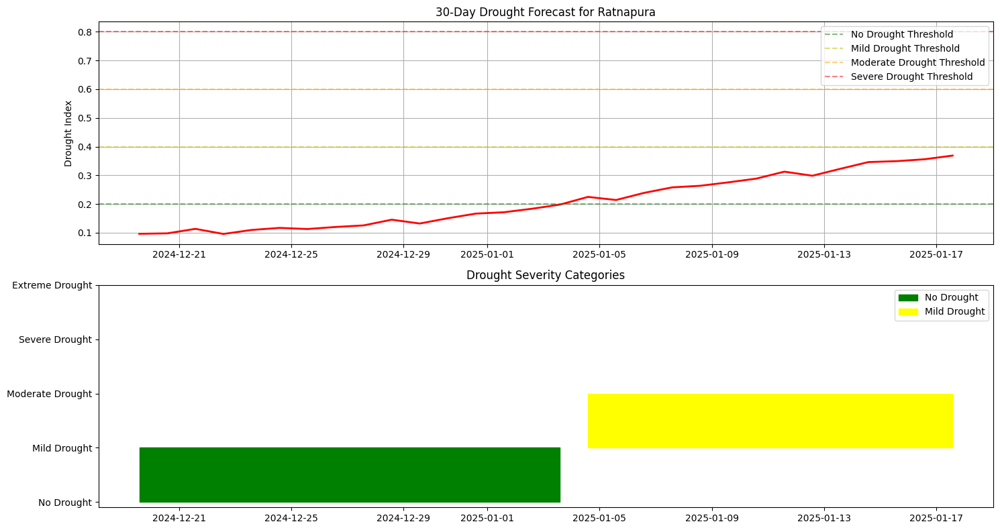


Analyzing drought conditions for Matara:

Predicted drought conditions over next 30 days:
Mild Drought: 21 days (70.0%)
No Drought: 8 days (26.7%)
Moderate Drought: 1 days (3.3%)


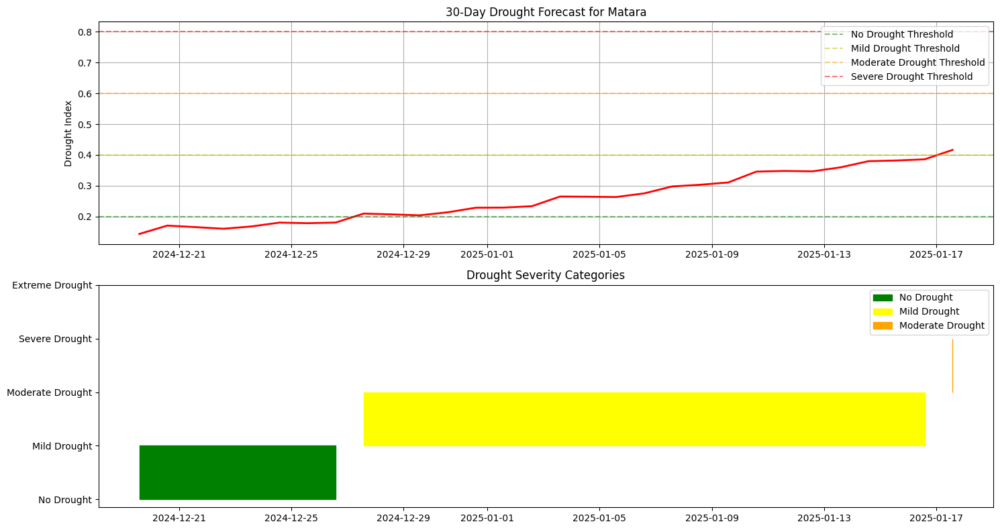

In [ ]:
# Execute the analysis
if __name__ == "__main__":
    results = main()

In [ ]:
import pandas as pd
import numpy as np
from prophet import Prophet
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from datetime import datetime, timedelta
import optuna
from sklearn.model_selection import TimeSeriesSplit
import torch
import torch.nn as nn
import logging
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Configure logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

In [ ]:
# Cell 2: Data preprocessing functions
class DataPreprocessor:
    def __init__(self, sequence_length=30):
        self.sequence_length = sequence_length
        self.scaler = StandardScaler()

    def create_sequences(self, data):
        """
        Create sequences for LSTM with proper reshaping
        Returns both sequences and corresponding targets
        """
        data_scaled = self.scaler.fit_transform(data.reshape(-1, 1))
        sequences = []
        targets = []

        for i in range(len(data_scaled) - self.sequence_length):
            seq = data_scaled[i:(i + self.sequence_length)]
            target = data_scaled[i + self.sequence_length]
            sequences.append(seq)
            targets.append(target)

        return np.array(sequences), np.array(targets)

    def prepare_features(self, df, feature):
        """
        Prepare features for all models with proper date handling
        """
        df = df.copy()

        # Create datetime features
        df['year'] = df['time'].dt.year
        df['month'] = df['time'].dt.month
        df['day'] = df['time'].dt.day
        df['day_of_week'] = df['time'].dt.dayofweek
        df['day_of_year'] = df['time'].dt.dayofyear
        df['week_of_year'] = df['time'].dt.isocalendar().week

        # Create lag features
        for lag in [1, 7, 14, 30]:
            df[f'{feature}_lag_{lag}'] = df[feature].shift(lag)

        # Create rolling statistics
        for window in [7, 14, 30]:
            df[f'{feature}_rolling_mean_{window}'] = df[feature].rolling(window=window).mean()
            df[f'{feature}_rolling_std_{window}'] = df[feature].rolling(window=window).std()
            df[f'{feature}_rolling_min_{window}'] = df[feature].rolling(window=window).min()
            df[f'{feature}_rolling_max_{window}'] = df[feature].rolling(window=window).max()

        return df

In [ ]:
# Cell 3: LSTM Model Definition
class WeatherLSTM(nn.Module):
    def __init__(self, input_size=1, hidden_size=64, num_layers=2):
        super(WeatherLSTM, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.lstm = nn.LSTM(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True,
            dropout=0.2
        )

        self.fc = nn.Sequential(
            nn.Linear(hidden_size, 32),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        batch_size = x.size(0)
        h0 = torch.zeros(self.num_layers, batch_size, self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_layers, batch_size, self.hidden_size).to(x.device)

        lstm_out, _ = self.lstm(x, (h0, c0))
        last_time_step = lstm_out[:, -1, :]
        out = self.fc(last_time_step)
        return out

In [ ]:
# Cell 4: Model Trainers
class ModelTrainer:
    def __init__(self, random_state=42):
        self.random_state = random_state

    def train_prophet(self, data):
        """Train Prophet model with robust parameters"""
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=True,
            daily_seasonality=False,
            seasonality_mode='multiplicative',
            interval_width=0.95,
            changepoint_prior_scale=0.05
        )
        model.fit(data)
        return model

    def train_tree_models(self, X, y):
        """Train tree-based models with optimized parameters"""
        models = {
            'rf': RandomForestRegressor(
                n_estimators=200,
                max_depth=15,
                min_samples_split=5,
                min_samples_leaf=2,
                random_state=self.random_state,
                n_jobs=-1
            ),
            'xgb': XGBRegressor(
                n_estimators=200,
                max_depth=7,
                learning_rate=0.05,
                subsample=0.8,
                colsample_bytree=0.8,
                random_state=self.random_state,
                n_jobs=-1
            ),
            'lgb': LGBMRegressor(
                n_estimators=200,
                max_depth=7,
                learning_rate=0.05,
                subsample=0.8,
                colsample_bytree=0.8,
                random_state=self.random_state,
                n_jobs=-1
            )
        }

        for name, model in models.items():
            logger.info(f"Training {name} model...")
            model.fit(X, y)

        return models

    def train_lstm(self, sequences, targets, batch_size=32, epochs=50):
        """Train LSTM model with proper batching and error handling"""
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

        # Convert to PyTorch tensors
        X_train = torch.FloatTensor(sequences).to(device)
        y_train = torch.FloatTensor(targets).to(device)

        # Initialize model
        model = WeatherLSTM().to(device)
        criterion = nn.MSELoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

        # Training loop
        model.train()
        for epoch in range(epochs):
            for i in range(0, len(X_train), batch_size):
                batch_X = X_train[i:i + batch_size]
                batch_y = y_train[i:i + batch_size]

                optimizer.zero_grad()
                outputs = model(batch_X)
                loss = criterion(outputs.squeeze(), batch_y.squeeze())
                loss.backward()
                optimizer.step()

            if (epoch + 1) % 10 == 0:
                logger.info(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

        return model


In [ ]:
# Cell 5: Ensemble Model
class WeatherEnsemble:
    def __init__(self, models, preprocessor):
        self.models = models
        self.preprocessor = preprocessor
        self.weights = None

    def optimize_weights(self, val_predictions, y_true):
        """Optimize ensemble weights using Optuna"""
        def objective(trial):
            weights = np.array([
                trial.suggest_float(f'weight_{i}', 0, 1)
                for i in range(len(val_predictions))
            ])
            weights = weights / np.sum(weights)  # Normalize weights

            ensemble_pred = np.zeros_like(y_true)
            for i, pred in enumerate(val_predictions):
                ensemble_pred += weights[i] * pred

            return mean_absolute_error(y_true, ensemble_pred)

        study = optuna.create_study(direction='minimize')
        study.optimize(objective, n_trials=100)

        # Get normalized weights
        self.weights = np.array([
            study.best_params[f'weight_{i}']
            for i in range(len(val_predictions))
        ])
        self.weights = self.weights / np.sum(self.weights)

        return self.weights

    def predict(self, inputs):
        """Generate ensemble predictions"""
        predictions = []
        for name, model in self.models.items():
            if name == 'prophet':
                pred = model.predict(inputs['prophet'])['yhat'].values
            elif name == 'lstm':
                with torch.no_grad():
                    pred = model(torch.FloatTensor(inputs['lstm'])).numpy().squeeze()
            else:  # Tree-based models
                pred = model.predict(inputs['trees'])
            predictions.append(pred)

        return np.average(predictions, weights=self.weights, axis=0)


In [ ]:
class DataPreprocessor:
    def __init__(self, sequence_length=30):
        self.sequence_length = sequence_length
        self.scaler = StandardScaler()

    def create_sequences(self, data):
        """
        Create sequences for LSTM with proper reshaping
        Returns both sequences and corresponding targets
        """
        # Ensure data is numeric before scaling
        data = pd.to_numeric(data, errors='coerce')
        # data = data.fillna(method='ffill')  # Forward fill any NaN values

        data_scaled = self.scaler.fit_transform(data.reshape(-1, 1))
        sequences = []
        targets = []

        for i in range(len(data_scaled) - self.sequence_length):
            seq = data_scaled[i:(i + self.sequence_length)]
            target = data_scaled[i + self.sequence_length]
            sequences.append(seq)
            targets.append(target)

        return np.array(sequences), np.array(targets)

    def prepare_features(self, df, feature):
        """
        Prepare features for all models with proper date handling
        """
        df = df.copy()

        # Ensure time column is datetime
        df['time'] = pd.to_datetime(df['time'])

        # Convert feature column to numeric, handling any non-numeric values
        if feature in df.columns:
            df[feature] = pd.to_numeric(df[feature], errors='coerce')
            df[feature] = df[feature].fillna(method='ffill')

        # Create datetime features
        df['year'] = df['time'].dt.year
        df['month'] = df['time'].dt.month
        df['day'] = df['time'].dt.day
        df['day_of_week'] = df['time'].dt.dayofweek
        df['day_of_year'] = df['time'].dt.dayofyear
        df['week_of_year'] = df['time'].dt.isocalendar().week

        # Create lag features with proper error handling
        for lag in [1, 7, 14, 30]:
            df[f'{feature}_lag_{lag}'] = df[feature].shift(lag)

        # Create rolling statistics
        for window in [7, 14, 30]:
            df[f'{feature}_rolling_mean_{window}'] = df[feature].rolling(window=window).mean()
            df[f'{feature}_rolling_std_{window}'] = df[feature].rolling(window=window).std()
            df[f'{feature}_rolling_min_{window}'] = df[feature].rolling(window=window).min()
            df[f'{feature}_rolling_max_{window}'] = df[feature].rolling(window=window).max()

        # Fill any remaining NaN values
        numeric_columns = df.select_dtypes(include=[np.number]).columns
        df[numeric_columns] = df[numeric_columns].fillna(method='ffill')
        df[numeric_columns] = df[numeric_columns].fillna(method='bfill')

        return df

In [ ]:
#Cell 6: Main Pipeline
def run_weather_forecast(df, feature, forecast_days=30):
    """Main function to run the ensemble forecast pipeline"""
    try:
        logger.info("Starting weather forecast pipeline...")

        # Validate input data
        if not isinstance(df, pd.DataFrame):
            raise ValueError("Input must be a pandas DataFrame")

        if 'time' not in df.columns:
            raise ValueError("DataFrame must contain a 'time' column")

        if feature not in df.columns:
            raise ValueError(f"Feature '{feature}' not found in DataFrame")

        # Initialize components
        preprocessor = DataPreprocessor()
        trainer = ModelTrainer()

        # Prepare data with additional validation
        logger.info("Preprocessing data...")
        df_processed = preprocessor.prepare_features(df, feature)

        # Verify no NaN values in processed data
        if df_processed[feature].isnull().any():
            raise ValueError(f"NaN values found in processed {feature} column")

        sequences, targets = preprocessor.create_sequences(df_processed[feature].values)

        # Prepare Prophet data
        prophet_data = pd.DataFrame({
            'ds': df_processed['time'],
            'y': df_processed[feature]
        })

        # Split data
        train_size = int(len(df_processed) * 0.8)
        feature_cols = [col for col in df_processed.columns
                       if col not in ['time', feature]]

        # Train models
        logger.info("Training Prophet model...")
        prophet_model = trainer.train_prophet(prophet_data[:train_size])

        logger.info("Training tree-based models...")
        tree_models = trainer.train_tree_models(
            df_processed[feature_cols][:train_size],
            df_processed[feature][:train_size]
        )

        logger.info("Training LSTM model...")
        lstm_model = trainer.train_lstm(
            sequences[:train_size],
            targets[:train_size]
        )

        # Combine all models
        models = {
            'prophet': prophet_model,
            'rf': tree_models['rf'],
            'xgb': tree_models['xgb'],
            'lgb': tree_models['lgb'],
            'lstm': lstm_model
        }

        # Create ensemble
        ensemble = WeatherEnsemble(models, preprocessor)

        # Generate future dates and features
        future_dates = pd.date_range(
            start=df_processed['time'].iloc[-1] + timedelta(days=1),
            periods=forecast_days,
            freq='D'
        )

        # Prepare prediction inputs
        prediction_inputs = {
            'prophet': pd.DataFrame({'ds': future_dates}),
            'trees': preprocessor.prepare_features(
                pd.DataFrame({'time': future_dates}),
                feature
            )[feature_cols],
            'lstm': sequences[-1:].copy()  # Use last sequence for LSTM
        }

        # Generate predictions
        predictions = ensemble.predict(prediction_inputs)

        return predictions, ensemble

    except Exception as e:
        logger.error(f"Error in forecast pipeline: {str(e)}")
        raise

In [ ]:
if __name__ == "__main__":
    # Load data
    df = pd.read_csv("SriLanka_Weather_Dataset.csv")
    df['time'] = pd.to_datetime(df['time'])

    # Run forecast
    feature = 'temperature_2m_max'
    predictions, ensemble = run_weather_forecast(df, feature)

    # Print results
    print("\nEnsemble Weights:")
    for model, weight in zip(['Prophet', 'RF', 'XGB', 'LGB', 'LSTM'],
                           ensemble.weights):
        print(f"{model}: {weight:.3f}")

    print("\nPredictions for next 30 days:")
    print(predictions)

DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/c2peiszu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/947qmomi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60308', 'data', 'file=/tmp/tmp9gqcfhd5/c2peiszu.json', 'init=/tmp/tmp9gqcfhd5/947qmomi.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modely1mmyoqb/prophet_model-20241221202255.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:22:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:24:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
ERROR:__main__:Error in forecast pipeline: could not convert string to float: '2010-01-01T00:52'


ValueError: could not convert string to float: '2010-01-01T00:52'

In [ ]:
# if __name__ == "__main__":
#     # Load your data
#     df = pd.read_csv("SriLanka_Weather_Dataset.csv")
#     df['time'] = pd.to_datetime(df['time'])

#     # Run ensemble forecast
#     feature = 'temperature_2m_max'
#     predictions, ensemble = run_ensemble_forecast(df, feature)

#     # Print results
#     print("Ensemble Weights:", ensemble.weights)
#     print("Predictions for next 30 days:", predictions)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/b8thlqlq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp9gqcfhd5/bcp5_45g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11839', 'data', 'file=/tmp/tmp9gqcfhd5/b8thlqlq.json', 'init=/tmp/tmp9gqcfhd5/bcp5_45g.json', 'output', 'file=/tmp/tmp9gqcfhd5/prophet_modelwhh_pai3/prophet_model-20241221194846.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:48:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:50:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004825 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2667
[LightGBM] [Info] Number of data points in the train set: 117984, number of used features: 16
[LightGBM] [Info] Start training from score 29.355044
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


IndexError: tuple index out of range